:::{index} single: Report writing
:::
:::{index} single: Simulations; Report writing
:::
:::{index} single: Scenarios; Report writing
:::
:::{index} single: Simulations; the keep option
:::

:::{index} single: Scenarios; the Keep option
:::

:::{index} single: Keep; the Keep option to retain scenario results
:::



In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
#This is code to manage dependencies if the notebook is executed in the google colab cloud service
if 'google.colab' in str(get_ipython()):
  import os
  os.system('apt -qqq install graphviz')
  os.system('pip -qqq install ModelFlowIb ipysheet  --no-dependencies ')


In [3]:
# Prepare the notebook for use of modelflow 

# Jupyter magic command to improve the display of charts in the Notebook
%matplotlib inline

# Import pandas 
import pandas as pd

# Import the model class from the modelclass module 
from modelclass import model 

# functions that improve rendering of modelflow outputs
model.widescreen()
#model.scroll_off();

# Report writing and scenario results

`ModelFlow`, is built on the back of  and inherits the functionalities of standard pandas routines and other python libraries like [matplotlib](https://matplotlib.org/), [seaborn](https://seaborn.pydata.org/), [plotly](https://plotly.com/), and [bokeh](https://bokeh.org/). These libraries are well-integrated with dataframes, and offer a wide-range of visualization capabilities. As has been done throughout this manual, they can be used to look at data, compare simulation results among other things. 

`ModelFlow` users are free to employ any Python-based library for visualization purposes. For specific tasks, notably ones that seek to take advantage of `ModelFlow` internal data structures, such as the dataframes holding the results from different simulations and  for tasks common to macroeconoic scenario analysis, `ModelFlow` includes some specific procedures derived from these other packages that may be of interest. In particular, these routines are tailored to utilize `ModelFlow` metadata such as variable descriptions and include specific transformations (like growth rates) and various scenario comparison visualizations that are useful in the analysis of macroeconomic model results.

## Summary

A **report** can be either a **table**, a **plot**  or a **text**. 

| Function | Creates |
|:----------|:-------------|
| `.table()` | A table based on the values in `.basedf` and `.lastdf` DataFrames. |
| `.plot` | One or more plots based on values in `keep_solutions` or in `.basedf` and `.lastdf`|
| `.text` | text, can be subdivided into plain, latex and html text using \<type>\</type> delimiters|

Tables, plots and text can be combined by the `|` operator. This operates only on the same report types and produces a new version of the report.

A **Report container**  can be constructed by the `+` operator. It can contain any mix of tables, plots, text and other report containers.   

Reports and report containers can be stored with `.add_report` and restored by`.get_report`. Stored reports and report containers are dumped together with model and data in `.pcim` when the `.modeldump` function is used. 

Note that stored reports and report containers will store the specification not the actual data and rendering. The specification can be used to create new reports based on the current content. 

Report(containers) can be displayed as string, html or pdf. 



## Load model object and simulation results from Scenario Analysis Chapter
To begin, a solution file that was saved at the end of the previous chapter is loaded, using the by now familiar modelload function.  Because the simulations performed in the previous chapter used the keep option, and because we saved the `mpakwScenarios.pcim` file with the keep option set to true, we will have access to all the simulation results from the previous chapter.

In [4]:
mpak,_ = model.modelload(r'..\models\mpakwScenarios.pcim',run=1)
_ = mpak.smpl(2025,2029)

Zipped file read:  ..\models\mpakwScenarios.pcim


The `.keep_solutions` dictionary can be interrogated to list all of the solutions (the keys) that were performed and stored in the previous chapter and the dataframes that were generated when the simulations were performed (the keys) in the dictionary.

In [5]:
for key,value in mpak.keep_solutions.items():
    print(key)

Baseline
$25 increase in oil prices 2025-27
2.5% increase in C 2025-40
2.5% increase in C 2025-27 -- exog whole period
2.5% increase in C 2025-27 -- exog whole period --KG=True
2.5% increase in C 2025-27 -- temporarily exogenized
1% of GDP increase in FDI and private investment (AF shock)


:::{index} single: Tables
:::

In addition the `mpak` model object includes the `.basedf` and `.lastdf` dataframes, which contain the values of model variables when initially loaded and following the latest simulation respectively.


In addition the `mpak` model object includes the `.basedf` and `.lastdf` dataframes, which contain the values of model variables when initially loaded and following the latest simulation respectively.

Tables are designed to look at reporting the `.basedf` and `.lastdf` so in this section the two dataframes are populated from the kept solutions. 

In [6]:
mpak.basedf = mpak.keep_solutions['Baseline']
mpak.lastdf = mpak.keep_solutions['1% of GDP increase in FDI and private investment (AF shock)']
mpak.smpl(2025,2029);

## The `.table()` function to create tables
:::{index} single: Reports; Tables
:::

This function creates standard tables with a minimum of fuss. It will create tables based on the values in `.basedf` and `.lastdf` DataFrames. By default, it creates tables with growth rates.

The function returns an instance of a class `DisplayVarTableDef`. This class has several useful methods and properties, which will be covered below.


A simple call is shown below. 
 
A **pattern** (pat) which defines some national account variables is created. Here the `*` wildchart is used, allowing this pattern to be used for models of other countries if the model conforms to standard naming conventions: 
 > pat='*NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN'

Also a **name** for the table is provided. This is used to avoid confusion when different tables are producing file output. 

Now an instance of the `DisplayVarTableDef` class can be created by a statement like this. 

 > tab = mpak.tab(name='My_first_table',pat=pat,title='GDP components,foot='Source: World bank ')

In addition a **title** and a **footnote** is also:

The variable tab contains the data and specification of a table. This in itself don't produce any output, but the `tab` object can be displayed and manipulated in various ways.

In [7]:
pat=  ' *NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN '
tab = mpak.table(name='My_first_table',pat=pat,title='GDP components',foot='Source: World bank ')

Now there are several possibilities for output: 

### Automatic display of a table in jupyter notebook 
By mentioning the `tab` as the last item in a cell the table will be displayed (using html). Alternative it tab is not the last item it can be displayed with 
 > display(tab)  
 
 In the next cell the table is displayed just by writing the name in the last line

In [8]:
tab

:::{image} tab1.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

This display will be scrollable it there are many years.

### `.show` Show the  table as text
The table can also be converted to text and displayed.

In [9]:
tab.show

GDP components
                         2025   2026   2027   2028   2029
                              --- Percent growth ---     
Real GDP                 2.08   2.42   2.64   4.36   2.91
HH. Cons Real            2.03   2.32   2.48   3.45   2.62
Investment real          1.10   1.46   1.82  12.46   2.98
Exports real             4.37   4.20   4.04   3.88   3.72
Imports real             3.10   3.10   3.02   4.68   2.84
Source: World bank 


### `.pdf` Creates a .pdf version of the table
Or the table can be made to a pdf file. 

In [10]:
tab.pdf() 

:::{image} tab1-pdf.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 90%
    :align: center
:::

The pdf file is displayed in the Jupyter Notebook with the standard pdf viewer and can be downloaded can be downloaded from there. Also the call
 >tab.pdf(xopen=1) 

Will open the pdf file in a separate viewer. 

### `transpose = True` Vertical tables
:::{index} single: Reports; Vertical tables
:::
Sometime tables have the years downward for instance in order to contain more years. This is done by adding the keyword: `transpose = True` when the table is created. In this case any number of years can be displayed, but the number of variables are limited by the width of the paper/screen. 

In [11]:
with mpak.set_smpl(2022,2027):
    tab_t = mpak.table(name='My_first_table',pat=pat,title='GDP components',
                       foot='Source: World bank ',transpose = True)
tab_t


### Different transformations of results - Growth Rates, Levels, etc.
:::{index} single: Reports; Tables, transformations of results
:::


When the `tab` function is invoked, it defaults to displaying the growth rates for specified variables. However, it supports various transformations to accommodate a wide range of applications. The specific transformation displayed is determined by the `datatype` argument, which can take the following values:

**Table: Data Types and Their Meanings**


| **datatype**    | **Meaning** |
|:-------------|:------------------------------------------------------------------|
| **growth**  | Growth rate in percent in the most recent dataset (`.lastdf`).   |
| difgrowth   | Change ($\Delta$) in growth rates from `.basedf` to `.lastdf`.   |
| gdppct      | Percentage of GDP in `.lastdf`.                                  |
| difgdppct   | Change ($\Delta$) in the percentage of GDP from `.basedf` to `.lastdf`. |
| level       | Values in `.lastdf`.                                            |
| diflevel    | Change ($\Delta$) in values from `.basedf` to `.lastdf`.         |
| difpctlevel | Percentage change ($\Delta$) in values from `.basedf` to `.lastdf`. |
| base        | Values in `.basedf`.                                            |
| basegrowth  | Growth rate in percent in `.basedf`.                            |
| basegdppct  | Percentage of GDP in `.basedf`.                                 |


For instance for some balances it makes sense to show the results in percent of GDP. This se done below by `datatype='gdppct'` 

In [12]:
pat_gov = '*GGBALOVRLCN *GGDBTTOTLCN *BNCABFUNDCD'
tab_gov = mpak.table(pat_gov,datatype='gdppct',title='In percent of GDP ',dec=1)
tab_gov.show

In percent of GDP 
                                              2025   2026   2027   2028   2029
                                                   --- Percent of GDP ---     
General Government Revenue, Deficit, LCU mn   -3.0   -3.0   -2.9   -2.8   -2.8
General government gross debt millions lcu    57.0   57.3   57.7   57.1   57.5
Current Account Balance, US$ mn               -3.6   -3.5   -3.4   -3.5   -3.4


### Making a new table by combining the content of several tables with  `|` 
:::{index} single: Reports; Tables, combining tables with  `|` 
:::


 In order to create tables with several datatypes, the content of a (not transposed table) tables can be added together by **`|`**

In [13]:
(tab | tab_gov).show

In percent of GDP 
                                              2025   2026   2027   2028   2029
                                                   --- Percent growth ---     
Real GDP                                      2.08   2.42   2.64   4.36   2.91
HH. Cons Real                                 2.03   2.32   2.48   3.45   2.62
Investment real                               1.10   1.46   1.82  12.46   2.98
Exports real                                  4.37   4.20   4.04   3.88   3.72
Imports real                                  3.10   3.10   3.02   4.68   2.84
                                                   --- Percent of GDP ---     
General Government Revenue, Deficit, LCU mn   -3.0   -3.0   -2.9   -2.8   -2.8
General government gross debt millions lcu    57.0   57.3   57.7   57.1   57.5
Current Account Balance, US$ mn               -3.6   -3.5   -3.4   -3.5   -3.4
Source: World bank 


### `Heading=` create a line with text. 
When constructing comprehensive tables by combining multiple tables, the heading parameter can be used to delineating distinct sections within the combined table. 

In [14]:
pat=  '*NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN'
pat_gov = '*GGBALOVRLCN *GGDBTTOTLCN *BNCABFUNDCD'

tab_na_base  = mpak.table(pat,    datatype='basegrowth',
                        heading=r'Baseline')
tab_gov_base = mpak.table(pat_gov,datatype='basegdppct')

tab_na       = mpak.table(pat,    datatype='growth',
                        heading=r'Alternative')
tab_gov      = mpak.table(pat_gov,datatype='gdppct')

tab_na_dif   = mpak.table(pat     ,datatype='difgrowth',
                        heading=r'Impact')
tab_gov_dif  = mpak.table(pat_gov ,datatype='difgdppct') 

tab_total    = tab_na_base | tab_gov_base |  tab_na | tab_gov | tab_na_dif | tab_gov_dif

# 
tab_total.show


Table
                                              2025   2026   2027   2028   2029
                                                          Baseline            
                                                   --- Percent growth ---     
Real GDP                                      2.08   2.42   2.64   2.79   2.91
HH. Cons Real                                 2.03   2.32   2.48   2.59   2.69
Investment real                               1.10   1.46   1.82   2.17   2.51
Exports real                                  4.37   4.20   4.04   3.90   3.77
Imports real                                  3.10   3.10   3.02   2.89   2.78
                                                   --- Percent of GDP ---     
General Government Revenue, Deficit, LCU mn  -3.05  -2.98  -2.95  -2.92  -2.91
General government gross debt millions lcu   57.02  57.26  57.69  58.26  58.94
Current Account Balance, US$ mn              -3.55  -3.46  -3.40  -3.37  -3.36
                                              

:::{index} single: Boxes; Box 3. Reports and latex 
:::

:::{admonition} Box 3. Reports and latex

In order to create pdf files Latex has to be installed on the machine. For this publication the Miktex package has been uses. More on installing
the framework here: [https://miktex.org/download](https://miktex.org/download) 

The pdf file is located here: `latex/<table name>/<table name>.pdf`. The latex source code is placed in `latex/<table name>/<table name>.tex` In case of errors or if the user want to enhance the output this file can be edited.  
            
:::


### Table overrun 
If a table covers many years it not a problem then it is displayed in the Jupyter notebook. but in latex and in print can it be a problem. This can be handled in several ways:

 - drop some middle columns
 - tisplay tables with chunks of data 
 - display a slice of data 


### Handling Table Overrun in LaTeX and Print

When dealing with tables that cover extensive time periods, such as multiple years, displaying them effectively in Jupyter Notebooks is straightforward. However, in LaTeX documents or printed materials, these tables can easily overrun the page and become impossible to read. To address this issue, several strategies can be employed:

- **Drop Middle Columns**: This involves removing several columns from the middle of the table that may not be critical to the reader’s understanding, helping to condense the table into a more manageable size.
  
- **Display Tables in Chunks**: Break the table into multiple smaller tables, each covering a shorter time span. This not only makes each segment easier to fit on a page but also can help readers digest the information in smaller, more focused increments.

- **Display a Slice of Data**: Rather than showing the entire timeline, you can display a specific segment or 'slice' of the data that is most relevant to the analysis at hand. This approach focuses the reader's attention and avoids overwhelming them with too much information at once.

These methods can significantly enhance the readability and presentation of long tables in formats that are less flexible than interactive digital platforms.



In [15]:
with mpak.set_smpl(2026,2050): 
    tab_long = mpak.table(pat,title='GDP components',name='long_table')

In [16]:
tab_long

`.show` use standard pandas functionaliuty 

In [17]:
tab_long.show 

GDP components
                         2026   2027   2028  ...   2048   2049   2050
                                    --- Percent growth ---           
Real GDP                 2.42   2.64   4.36  ...   3.31   3.31   3.31
HH. Cons Real            2.32   2.48   3.45  ...   3.16   3.16   3.17
Investment real          1.46   1.82  12.46  ...   4.31   4.30   4.28
Exports real             4.20   4.04   3.88  ...   2.68   2.66   2.64
Imports real             3.10   3.02   4.68  ...   2.78   2.81   2.85


`.pdf` use places a vertical line in order to signal missing columns 

the behavior can be controlled (more to come) 

also timeslice to specify exactly which to display (more to come) 

In [18]:
tab_long.pdf() 

:::{image} tab-long.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

### Use `timeslice = ` to limit the number of years. 
This allows selection of the years to display. `timeslicce` gives full control over the time for which the data is displayed. Beware, timeslice don't care if years are out of order. It will show what you ask for. 

In [19]:
tab_long.set_options(timeslice=[2026,2040,2028 ,2029,2050]).show

GDP components
                         2026   2040   2028   2029   2050
                              --- Percent growth ---     
Real GDP                 2.42   3.41   4.36   2.91   3.31
HH. Cons Real            2.32   3.17   3.45   2.62   3.17
Investment real          1.46   4.29  12.46   2.98   4.28
Exports real             4.20   2.93   3.88   3.72   2.64
Imports real             3.10   2.58   4.68   2.84   2.85


### `col_desc =`  Userdefined column description 
´.table´ will use a default column description based on the **datatype**. However it can be changed.  

In [20]:
mpak.table(pat,datatype = 'diflevel').show

Table
                        2025   2026   2027        2028        2029
                                  --- Impact, Level ---           
Real GDP                0.09   0.13   0.15  462,356.95  474,302.36
HH. Cons Real           0.08   0.11   0.13  227,277.35  214,784.82
Investment real         0.03   0.04   0.05  336,198.32  361,924.23
Exports real           -0.00  -0.00  -0.00     -530.53   -2,078.90
Imports real            0.05   0.06   0.08  139,488.09  148,662.29


In [21]:
mpak.table(pat,datatype = 'diflevel',
           col_desc     = 'Delta, LCU 2000 base'
                                   ).show

Table
                               2025   2026   2027        2028        2029
                                      --- Delta, LCU 2000 base ---       
Real GDP                       0.09   0.13   0.15  462,356.95  474,302.36
HH. Cons Real                  0.08   0.11   0.13  227,277.35  214,784.82
Investment real                0.03   0.04   0.05  336,198.32  361,924.23
Exports real                  -0.00  -0.00  -0.00     -530.53   -2,078.90
Imports real                   0.05   0.06   0.08  139,488.09  148,662.29


### Default Values for col_desc

Below is listed the default values for `col_desc` for the different datatypes. As mentioned above, the user can modify both `col_desc` and `heading` if needed. If `col_desc` are set to blank `''`, the line will not show.

| **datatype**   | **col_desc**             |
|:---------------|:-------------------------|
| **growth**     | Percent growth           |
| **difgrowth**  | Impact, Percent growth   |
| **gdppct**     | Percent of GDP           |
| **difgdppct**  | Impact, Percent of GDP   |
| **level**      | Level                    |
| **diflevel**   | Impact, Level            |
| **difpctlevel**| Impact in percent        |
| **base**       | Level                    |
| **basegrowth** | Percent growth           |
| **basegdppct** | Percent of GDP           |


## The `.plot` function to plot scenarios. 
:::{index} single: Reports; Plots
:::

A close sibling of the `.table` function this function creates standard plots with a minimum of fuss. It will create plots based on the values in either ´.keep_solutions´ or `.basedf` and `.lastdf` DataFrames. By default, it creates tables with growth rates.

The function returns an instance of a class `DisplayVarFigDef`. 

A simple call is shown below. 
 
A **pattern** (pat_plot) which defines some variables is created. Here the `*` wildchart is used, allowing this pattern to be used for models of other countries if the model conforms to standard naming conventions: 
 > pat_plot=  '*NYGDPMKTPKN *NECONPRVTKN  '

Also a **name** for the table is provided. This is used to avoid confusion when different tables are producing file output. 

Now an instance of the `DisplayVarFigDef` class can be created by a statement like this. 

 > fig = mpak.plot(pat_plot,name='My first plot')

In addition a **title** is also provided:

The variable fig contains the data and specification of a several plots. This in itself don't produce any output, but the `fig` object can be displayed and manipulated in various ways.


As plots typical show more years than a table the `smpl`is set for a longer periode. 

In [28]:
mpak.smpl(2020,2050)
pat_plot=  '*NYGDPMKTPKN *NECONPRVTKN  '
fig = mpak.plot(pat_plot,name='My first plot')

### `.show` Show the  plot

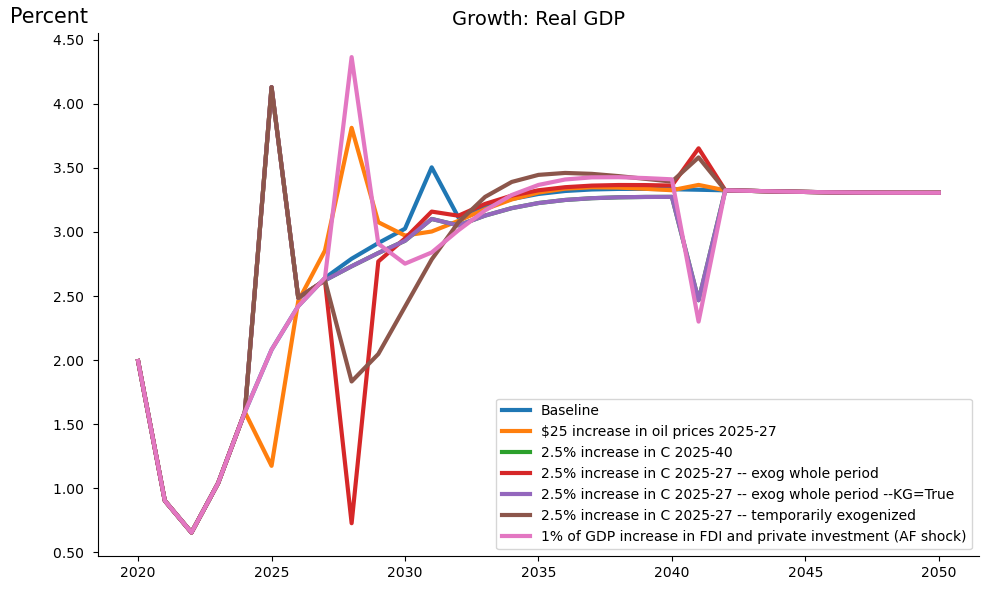

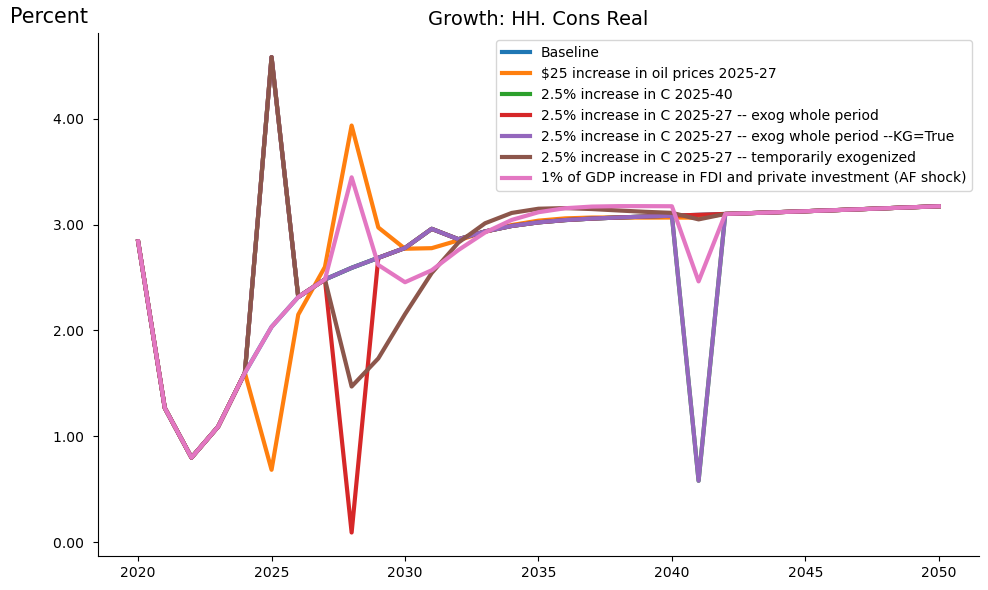

In [29]:
fig.show

### Automatic display of plots
Just like tables plots can be automatic displayed just by mentioning the variable as the last line or by: 
 > display(fig)
 
 The plots will be shown in a tabbed "accodium" so the user can select on which plot to focus. 

In [24]:
fig

Accordion(children=(HTML(value='<?xml version="1.0" encoding="utf-8" standalone="no"?>\n<!DOCTYPE svg PUBLIC "…

:::{image} fig.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

### `.pdf` Creates a .pdf version of the plots
As shown below

In [25]:
fig.pdf() 

:::{image} fig-pdf.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

**Plots: Data Types and Their Meanings**


| **datatype**    | **Meaning** |
|:-------------|:------------------------------------------------------------------|
| **growth**  | Growth rate in percent    |
| difgrowth   | Impact ($\Delta$) in growth rates   |
| gdppct      | Percentage of GDP                                |
| difgdppct   | Impact ($\Delta$) in the percentage of GDP  |
| level       | Values                                            |
| diflevel    | Impact ($\Delta$) in values |
| difpctlevel | Percentage impact ($\Delta$) in values  |

### `.set_options` Set options 
The `fig.set_options()` will return a new and modified plot instance. In the example below the option`samefig` is set to `True` this will put the plots into one figure. This is useful to create figures containing plots with different transformations (as described below). Also a title is set.   

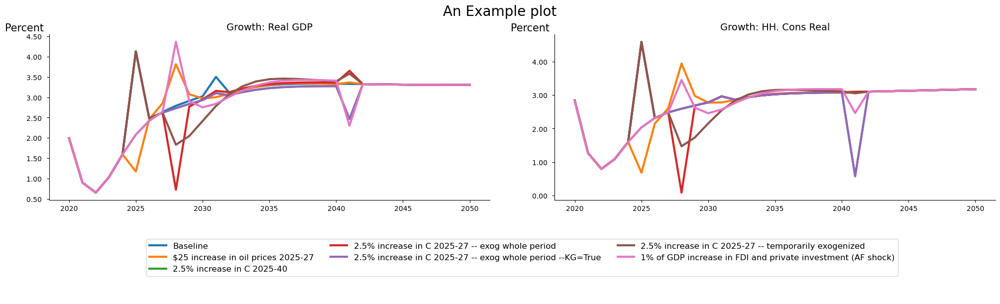

In [34]:
fig.set_options(samefig=True,title='An Example plot').show

| Attribute           | Default Value             | Description                                                                                     |
|---------------------|---------------------------|-------------------------------------------------------------------------------------------------|
| name                | 'Display'                 | Name for this display.   |
| rename              | True                      | If True use descriptions else variable names    |
| custom_description  | {}        | Custom description, override default descriptions.                         |
| title               | ''          | Title.                                                                             |

| foot                | ''            | Footer if relevant. |

| width               | 20                        | Specifies the width for formatting output in characters.                                         |
| transpose           | False                     | If True, transposes the display output.                                                         |
| chunk_size          | 0                         | Specifies the number of columns per chunk in tables.                                 |
| timeslice           | []             | Specifies the time slice for data display.                                                      |
| max_cols            | 6                         | Maximum columns when displayed as string.                                                       |
| last_cols           | 1                         | In Latex, the number of last columns in a display slice.                   |

| samefig             | False                     | If True, displays all figures in the same plot area.                                            |
| ncol                | 2                         | Number of columns in the in when samefig=True.                                                               |
| size                | (10, 6)                   | Specifies the size of the figure output.                                                       |
| legend              | True                      | If True, includes a legend in the display.                                                      |


| Attribute           | Default Value             | Description                                                                                     |
|---------------------|---------------------------|-------------------------------------------------------------------------------------------------|
| name                | 'Display'                 | Name for this display.                                                                          |
| rename              | True                      | If True, allows renaming of data columns.                                                       |
| width               | 20                        | Specifies the width for formatting output in characters.                                         |
| transpose           | False                     | If True, transposes the display output.                                                         |
| custom_description  | (empty dictionary)        | Custom description, override default descriptions.                         |
| title               | ''          | Text for the title.                                                                             |
| chunk_size          | 0                         | Specifies the number of columns per chunk in tables.                                 |
| timeslice           | []             | Specifies the time slice for data display.                                                      |
| max_cols            | 6                         | Maximum columns when displayed as string.                                                       |
| last_cols           | 1                         | In Latex, the number of last columns in a display slice.                   |
| samefig             | False                     | If True, displays all figures in the same plot area.                                            |
| ncol                | 2                         | Number of columns in the in when samefig=True.                                                               |
| size                | (10, 6)                   | Specifies the size of the figure output.                                                       |
| legend              | True                      | If True, includes a legend in the display.                                                      |


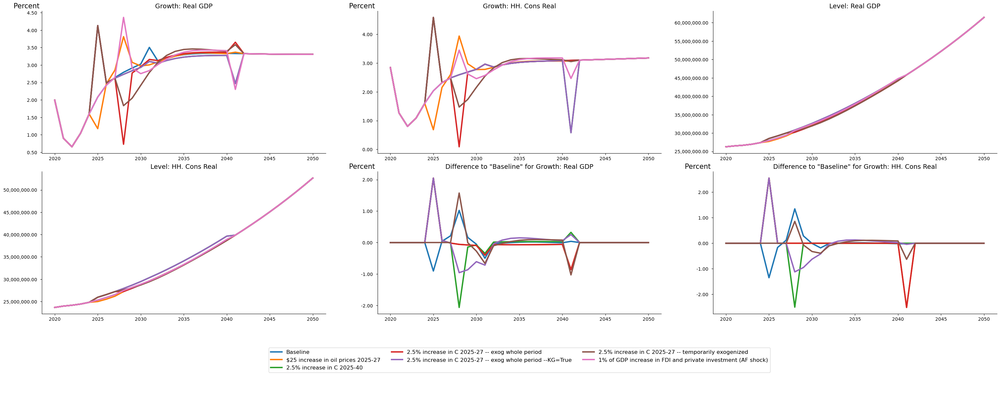

In [51]:
fig1 = mpak.plot(pat_plot,datatype='level',name='Level')
fig2 = mpak.plot(pat_plot,datatype='difgrowth',name= 'dif')
fig_join = (fig | fig1 | fig2).set_options(samefig=True,ncol=3,name='fig_join')
fig_join.show

In [52]:
mpak.add_report(fig_join)

Reports added to report repo: fig_join


In [53]:
mpak.reports.keys() 

dict_keys(['My first plot_A_plot_A_plot', 'My first plot_Level_dif', 'fig_join'])

In [ ]:
mpak.get_report('Report_test')

The tables and charts will not contain the data, but the specification. So if run in a different content it 
will contain the data. 

In [ ]:
test =  (r'''Here we se the growth rates in the different scenarios 
         First a chart <latex>
\title{An example report file from modelflow }
\author{Ib Hansen}
\date{\today} 

% Create the title page
\maketitle
\tableofcontents
\newpage
\section{First a chart} 
Here we se the growth rates in the different scenarios
''' + 
fig1 + 
r' <latex>\section{then a chart}' + 
fig2 + 
r'<latex> \section{And a table}'  +
tab_total + tab_t)
test.pdf()   

In [ ]:
with mpak.set_smpl(2000,2050):
    tab5 = mpak.table(name='My_first_table',pat=pat+pat+pat,title='GDP components',
                      foot='Source: World bank ',transpose =1)
tab5    

<style type="text/css">
#T_be2df .row_heading {
  position: sticky;
  left: 0;
  z-index: 3;
  background-color: white;
  width: 300px;
  min-width: 200px;
  max-width: 400px;
}
#T_be2df  .corner {
  position: sticky;
  left: 0;
  z-index: 3;
  background-color: white;
  width: 300px;
  min-width: 200px;
  max-width: 400px;
}
#T_be2df .col_heading {
  position: sticky;
  top: 0;
  z-index: 2;
  background-color: white;
}
#T_be2df th {
  text-align: left;
  background-color: white;
  z-index: 2;
}
#T_be2df td {
  z-index: 1;
}
#T_be2df caption {
  font-size: 16px;
  font-weight: bold;
}
</style>
<table id="T_be2df">
  <caption>GDP components</caption>
  <thead>
    <tr>
      <th class="blank level0" >&nbsp;</th>
      <th id="T_be2df_level0_col0" class="col_heading level0 col0" >2025</th>
      <th id="T_be2df_level0_col1" class="col_heading level0 col1" >2026</th>
      <th id="T_be2df_level0_col2" class="col_heading level0 col2" >2027</th>
      <th id="T_be2df_level0_col3" class="col_heading level0 col3" >2028</th>
      <th id="T_be2df_level0_col4" class="col_heading level0 col4" >2029</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th id="T_8eb89_level0_row0" class="row_heading level0 row0" colspan="5">--- Percent growth ---</th>
    </tr>
    <tr>
      <th id="T_be2df_level0_row1" class="row_heading level0 row1" >Real GDP</th>
      <td id="T_be2df_row1_col0" class="data row1 col0" >2.08</td>
      <td id="T_be2df_row1_col1" class="data row1 col1" >2.42</td>
      <td id="T_be2df_row1_col2" class="data row1 col2" >2.64</td>
      <td id="T_be2df_row1_col3" class="data row1 col3" >4.36</td>
      <td id="T_be2df_row1_col4" class="data row1 col4" >2.91</td>
    </tr>
    <tr>
      <th id="T_be2df_level0_row2" class="row_heading level0 row2" >HH. Cons Real</th>
      <td id="T_be2df_row2_col0" class="data row2 col0" >2.03</td>
      <td id="T_be2df_row2_col1" class="data row2 col1" >2.32</td>
      <td id="T_be2df_row2_col2" class="data row2 col2" >2.48</td>
      <td id="T_be2df_row2_col3" class="data row2 col3" >3.45</td>
      <td id="T_be2df_row2_col4" class="data row2 col4" >2.62</td>
    </tr>
    <tr>
      <th id="T_be2df_level0_row3" class="row_heading level0 row3" >Investment real</th>
      <td id="T_be2df_row3_col0" class="data row3 col0" >1.10</td>
      <td id="T_be2df_row3_col1" class="data row3 col1" >1.46</td>
      <td id="T_be2df_row3_col2" class="data row3 col2" >1.82</td>
      <td id="T_be2df_row3_col3" class="data row3 col3" >12.46</td>
      <td id="T_be2df_row3_col4" class="data row3 col4" >2.98</td>
    </tr>
    <tr>
      <th id="T_be2df_level0_row4" class="row_heading level0 row4" >Exports real</th>
      <td id="T_be2df_row4_col0" class="data row4 col0" >4.37</td>
      <td id="T_be2df_row4_col1" class="data row4 col1" >4.20</td>
      <td id="T_be2df_row4_col2" class="data row4 col2" >4.04</td>
      <td id="T_be2df_row4_col3" class="data row4 col3" >3.88</td>
      <td id="T_be2df_row4_col4" class="data row4 col4" >3.72</td>
    </tr>
    <tr>
      <th id="T_be2df_level0_row5" class="row_heading level0 row5" >Imports real</th>
      <td id="T_be2df_row5_col0" class="data row5 col0" >3.10</td>
      <td id="T_be2df_row5_col1" class="data row5 col1" >3.10</td>
      <td id="T_be2df_row5_col2" class="data row5 col2" >3.02</td>
      <td id="T_be2df_row5_col3" class="data row5 col3" >4.68</td>
      <td id="T_be2df_row5_col4" class="data row5 col4" >2.84</td>
    </tr>
  </tbody>
<tfoot><tr><td colspan='5' style='text-align: left;'>Source: World bank </td></tr></tfoot></table>



In [ ]:
c1 = '<h1> Testing <h1/>'+tab
c1

In [ ]:
c2 = '<h1> Testing <h1/>' + tab

In [ ]:
c1 +fig1 +c2

In [ ]:
from modelreport import get_DisplayTextDef

In [ ]:
xx = get_DisplayTextDef('testing')

In [ ]:
 xx | 'dddd'


In [ ]:
xx

In [ ]:
xx = (tab | tab_gov)  
xx.show

## `.reports` Stored report (display) definitions for later use
The definitions of the different tables (and later charts) can be stores in a 
dictionary called `reports` In this way the definitions can be reused at a later state. 
Notice it is the definition not the content of the table which is stored.So when applied in another model class instance the result will reflect state of play at this instance.  

Also the `.report` dict is saved when the model is dumped with `.modeldump` and restored when the function `model.modelload()` is used to load a model. 

#### `.add_report` add a report specification to the `.reports` dictionary. 

In [ ]:
mpak.add_report([tab_long,tab_total])

In [ ]:
mpak.reports.keys() 

#### `.get_report` create a report from a stored specification. 

In [ ]:
mpak.get_report('A_small_table').pdf()  

### Reports are stored in `.pcim` files, and restored when a model is loaded
When a report has been saved it will be dumped together with equations, data and other information when a `.modeldump` is performed. This allows 
the user to easy to recreate the table or chart with other scenarios. 

So first dump the model and data: 

In [ ]:
mpak.modeldump('testpak',keep=True)

Then read the model and data into new variables. 

In [ ]:
xpak,baseline = model.modelload('testpak',run=True  )

In [ ]:
xpak.basedf = xpak.keep_solutions['Baseline']
xpak.lastdf = xpak.keep_solutions['1% of GDP increase in FDI and private investment (AF shock)']

Now the saved tables can be recreated 

In [ ]:
xpak.get_report('A_small_table').show